# Project - P411 Stock Market Analysis

### Reliance Industries

#### Stock Analysis and Forecasting

### Business Objective

Predict the Reliance Industries Stock Price for the next 5 years days.

There are Open, High, Low and Close prices that you need to obtain from the web for each day starting from 1991 to 2023 for Reliance Industries stock.

Split the last year into a test set- to build a model to predict stock price.

Find short term, & long term trends.

Understand how it is impacted from external factors or any big external events.

Forecast for next 5 years from 2024 to 2029.

# Problem statement
    1. collect data of Reliance Industries Limited Stock Price from year 1990 to 2023.
    2. For the Closing Price and Volume, make a forecast for the next 5 years, i.e. from 2024 to 2029.
    3. Also find the factors that influence the stock prices and any special events during this period.
    4. Using Streamlit, deploy the model with the best accuracy.

<h2><font color = "blue">Step 1: EDA </h2>

### steps in Data Pre-processing
## Reading the data and observing the data format and shape 
<h3><li><font color ="blue">Observed the data has 8149 instances with 7 features</li></h3>
<li>All the data types were objects</li>
<li>So converted the date object format to date</li>
<li>For all the other columns it was converted to float by replacing the characters</li>
<li>Null values are replaced with median </li>

In [2]:
import pandas as pd
import numpy as np

df = pd.read_csv("combined.csv")
df.head(10)

,Date,Price,Open,High,Low,Vol.,Change %
0,12/29/2023,"2,584.85","2,608.05","2,614.80","2,579.15",848.45K,-0.80%
1,12/28/2023,"2,605.80","2,587.00","2,611.35","2,587.00",183.81K,0.75%
2,12/27/2023,"2,586.35","2,578.50","2,599.35","2,572.25",103.81K,0.34%
3,12/26/2023,"2,577.50","2,570.00","2,592.90","2,563.00",90.28K,0.50%
4,12/22/2023,"2,564.70","2,562.20","2,580.55","2,548.00",524.56K,0.10%
5,12/21/2023,"2,562.20","2,510.45","2,572.50","2,510.45",364.80K,1.38%
6,12/20/2023,"2,527.35","2,560.30","2,597.85","2,520.00",649.41K,-1.22%
7,12/19/2023,"2,558.45","2,537.70","2,573.00","2,525.85",234.38K,1.53%
8,12/18/2023,"2,519.95","2,494.20","2,534.40","2,491.05",196.18K,0.99%
9,12/15/2023,"2,495.20","2,472.15","2,499.95","2,469.05",681.58K,1.25%


### Data Preprocessing

In [3]:
df.shape

(8149, 7)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8149 entries, 0 to 8148
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Date      8149 non-null   object
 1   Price     8149 non-null   object
 2   Open      8149 non-null   object
 3   High      8149 non-null   object
 4   Low       8149 non-null   object
 5   Vol.      6929 non-null   object
 6   Change %  8149 non-null   object
dtypes: object(7)
memory usage: 445.8+ KB


In [5]:
# Convert 'Date' to datetime format
df['Date'] = pd.to_datetime(df['Date'])

In [6]:
df.head()

,Date,Price,Open,High,Low,Vol.,Change %
0,2023-12-29,"2,584.85","2,608.05","2,614.80","2,579.15",848.45K,-0.80%
1,2023-12-28,"2,605.80","2,587.00","2,611.35","2,587.00",183.81K,0.75%
2,2023-12-27,"2,586.35","2,578.50","2,599.35","2,572.25",103.81K,0.34%
3,2023-12-26,"2,577.50","2,570.00","2,592.90","2,563.00",90.28K,0.50%
4,2023-12-22,"2,564.70","2,562.20","2,580.55","2,548.00",524.56K,0.10%


In [7]:
# Remove commas from 'Price', 'Open', 'High', 'Low' and convert to float
df['Price'] = df['Price'].str.replace(',', '').astype(float)
df['Open'] = df['Open'].str.replace(',', '').astype(float)
df['High'] = df['High'].str.replace(',', '').astype(float)
df['Low'] = df['Low'].str.replace(',', '').astype(float)

In [8]:
# Convert 'Vol.' to numeric (remove 'K' and 'M' and convert to appropriate number)
def convert_volume(vol):
    if 'K' in vol:
        return float(vol.replace('K', '').replace(',', '')) * 1e3
    elif 'M' in vol:
        return float(vol.replace('M', '').replace(',', '')) * 1e6
    else:
        return float(vol.replace(',', ''))

# Apply the conversion to 'Vol.' column
df['Vol.'] = df['Vol.'].apply(lambda x: convert_volume(x) if pd.notnull(x) else np.nan)

In [9]:
df.head(10)

,Date,Price,Open,High,Low,Vol.,Change %
0,2023-12-29,2584.85,2608.05,2614.80,2579.15,848450.0,-0.80%
1,2023-12-28,2605.80,2587.00,2611.35,2587.00,183810.0,0.75%
2,2023-12-27,2586.35,2578.50,2599.35,2572.25,103810.0,0.34%
3,2023-12-26,2577.50,2570.00,2592.90,2563.00,90280.0,0.50%
4,2023-12-22,2564.70,2562.20,2580.55,2548.00,524560.0,0.10%
5,2023-12-21,2562.20,2510.45,2572.50,2510.45,364800.0,1.38%
6,2023-12-20,2527.35,2560.30,2597.85,2520.00,649410.0,-1.22%
7,2023-12-19,2558.45,2537.70,2573.00,2525.85,234380.0,1.53%
8,2023-12-18,2519.95,2494.20,2534.40,2491.05,196180.0,0.99%
9,2023-12-15,2495.20,2472.15,2499.95,2469.05,681580.0,1.25%


In [10]:
# Convert 'Change %' to numeric (remove '%' and convert to float)
df['Change %'] = df['Change %'].str.replace('%', '').astype(float)

In [11]:
df.head(10)

,Date,Price,Open,High,Low,Vol.,Change %
0,2023-12-29,2584.85,2608.05,2614.80,2579.15,848450.0,-0.80
1,2023-12-28,2605.80,2587.00,2611.35,2587.00,183810.0,0.75
2,2023-12-27,2586.35,2578.50,2599.35,2572.25,103810.0,0.34
3,2023-12-26,2577.50,2570.00,2592.90,2563.00,90280.0,0.50
4,2023-12-22,2564.70,2562.20,2580.55,2548.00,524560.0,0.10
5,2023-12-21,2562.20,2510.45,2572.50,2510.45,364800.0,1.38
6,2023-12-20,2527.35,2560.30,2597.85,2520.00,649410.0,-1.22
7,2023-12-19,2558.45,2537.70,2573.00,2525.85,234380.0,1.53
8,2023-12-18,2519.95,2494.20,2534.40,2491.05,196180.0,0.99
9,2023-12-15,2495.20,2472.15,2499.95,2469.05,681580.0,1.25


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8149 entries, 0 to 8148
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Date      8149 non-null   datetime64[ns]
 1   Price     8149 non-null   float64       
 2   Open      8149 non-null   float64       
 3   High      8149 non-null   float64       
 4   Low       8149 non-null   float64       
 5   Vol.      6929 non-null   float64       
 6   Change %  8149 non-null   float64       
dtypes: datetime64[ns](1), float64(6)
memory usage: 445.8 KB


In [13]:
df['Vol.'].isnull().sum()

1220

In [14]:
# Replace null values in volume column with its median values
df['Vol.'] = df['Vol.'].fillna(df['Vol.'].median())

In [15]:
df['Vol.'].isnull().sum()

0

### Visualization

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

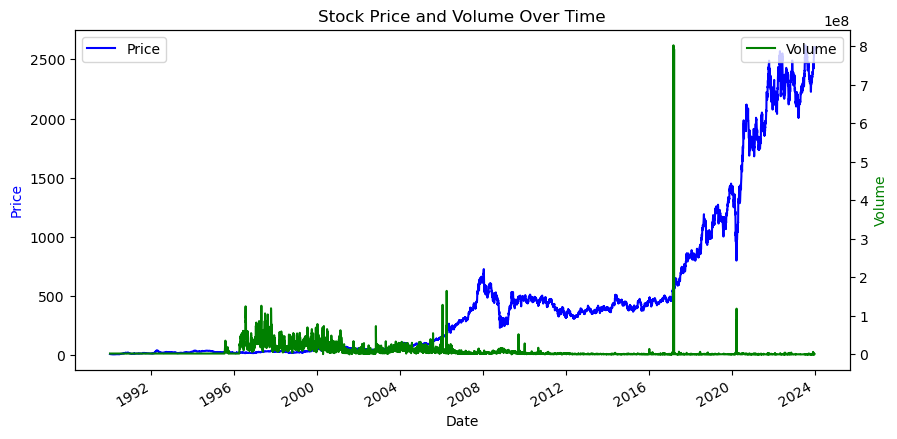

In [17]:
# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(10, 5))

# Plot the price
df.plot(x='Date', y='Price', ax=ax1, color='b', label='Price')

# Create a second y-axis to plot the volume
ax2 = ax1.twinx()

# Plot the volume
sns.lineplot(x='Date', y='Vol.', data=df, ax=ax2, color='g', label='Volume')

# Set the labels and title
ax1.set_xlabel('Date')
ax1.set_ylabel('Price', color='b')
ax2.set_ylabel('Volume', color='g')
plt.title('Stock Price and Volume Over Time')

# Show the plot
plt.show()

<h2><font color ="blue"> The values are sorted as per the date</h2>

In [18]:
df.sort_values(by='Date', inplace=True)
df.head()

,Date,Price,Open,High,Low,Vol.,Change %
8148,1990-01-02,7.27,7.31,7.44,7.14,2250000.0,-1.62
8147,1990-01-03,6.92,7.18,7.18,6.84,2250000.0,-4.81
8146,1990-01-04,6.50,6.24,6.58,6.24,2250000.0,-6.07
8145,1990-01-05,6.71,6.37,6.71,6.37,2250000.0,3.23
8144,1990-01-08,6.71,7.05,7.05,6.67,2250000.0,0.00


<h2><font color ="blue"> Understanding the relationship of features monthwise and yearwise can gain some insight about the trend with respect to the open price and closing price, thus the data is grouped by date converting it to a string </h2>

In [19]:
monthvise= df.groupby(df['Date'].dt.strftime('%B'))[['Open','Price']].mean().sort_values(by='Price')
monthvise.head()

,Open,Price
Date,,
February,440.905822,440.642579
March,444.641521,444.426987
January,455.472266,454.273463
April,462.524416,462.860032
May,466.601883,465.805093


In [20]:
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

In [21]:
fig = go.Figure()

fig.add_trace(go.Bar(
    x=monthvise.index,
    y=monthvise['Open'],
    name='Stock Open Price',
    marker_color='crimson'
))
fig.add_trace(go.Bar(
    x=monthvise.index,
    y=monthvise['Price'],
    name='Stock Close Price',
    marker_color='lightsalmon'
))

fig.update_layout(barmode='group', xaxis_tickangle=-45, 
                  title='Monthwise comparision between Open value and Price')
fig.show()

In [22]:
monthvise1= df.groupby(df['Date'].dt.strftime('%B'))[['Vol.','Price']].mean().sort_values(by='Price')
monthvise1.head()

,Vol.,Price
Date,,
February,6.716279e+06,440.642579
March,1.153889e+07,444.426987
January,7.974786e+06,454.273463
April,8.065311e+06,462.860032
May,6.455273e+06,465.805093


In [23]:
fig = go.Figure()

fig.add_trace(go.Bar(
    x=monthvise1.index,
    y=monthvise1['Vol.'],
    name='Stock Volume',
    marker_color='crimson'
))
fig.add_trace(go.Bar(
    x=monthvise1.index,
    y=monthvise1['Price'],
    name='Stock Close Price',
    marker_color='lightsalmon'
))

fig.update_layout(barmode='group', xaxis_tickangle=-45, 
                  title='Monthwise comparision between Volume and Close Price')
fig.show()

In [24]:
df.groupby(df['Date'].dt.strftime('%B'))['Low'].min()

Date
April         4.87
August        8.80
December     10.26
February      4.40
January       5.30
July          7.01
June          5.26
March         4.27
May           5.09
November     12.99
October      13.42
September    12.99
Name: Low, dtype: float64

In [25]:
monthvise_high= df.groupby(df['Date'].dt.strftime('%B'))['High'].max()
monthvise_low= df.groupby(df['Date'].dt.strftime('%B'))['Low'].min()

In [26]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=monthvise_high.index,
    y=monthvise_high,
    name='Stock high Price',
    marker_color='rgb(0, 153, 204)'
))
fig.add_trace(go.Bar(
    x=monthvise_low.index,
    y=monthvise_low,
    name='Stock low Price',
    marker_color='rgb(255, 128, 0)'
))

fig.update_layout(barmode='group', 
                  title=' Monthwise High and Low stock price')
fig.show()

In [27]:
monthvise_volhigh= df.groupby(df['Date'].dt.strftime('%B'))['Vol.'].max()
monthvise_vollow= df.groupby(df['Date'].dt.strftime('%B'))['Vol.'].min()

In [28]:
fig = go.Figure()
fig.add_trace(go.Bar(
    x=monthvise_volhigh.index,
    y=monthvise_volhigh,
    name='Stock volume high Price',
    marker_color='rgb(0, 153, 204)'
))
fig.add_trace(go.Bar(
    x=monthvise_vollow.index,
    y=monthvise_vollow,
    name='Stock volume low Price',
    marker_color='rgb(255, 128, 0)'
))

fig.update_layout(barmode='group', 
                  title=' Monthwise High and Low volume')
fig.show()

In [29]:
from itertools import cycle
names = cycle(['Stock Open Price','Stock Close Price','Stock High Price','Stock Low Price','volume'])

fig = px.line(df, x=df.Date, y=[df['Open'], df['Price'], 
                                          df['High'], df['Low']],
                                         
             labels={'Date': 'Date','value':'Stock value'})
fig.update_layout(title_text='Stock analysis chart', font_size=15, font_color='black',legend_title_text='Stock Parameters')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)

fig.show()

In [30]:
from itertools import cycle
names = cycle(['Stock Close Price','Stock Open Price','volume'])

fig = px.line(df, x=df.Date, y=[df['Open'], df['Price'], 
                                          df['Vol.'], df['Price']],
                                         
             labels={'Date': 'Date','value':'Stock value'})
fig.update_layout(title_text='Stock analysis chart', font_size=15, font_color='black',legend_title_text='Stock Parameters')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)

fig.show()

In [31]:
closedf = df[['Date','Price']]
print("Shape of close dataframe:", closedf.shape)

Shape of close dataframe: (8149, 2)


In [32]:
fig = px.line(closedf, x=closedf.Date, y=closedf.Price,labels={'Date':'Date','Price':'Close Stock'})
fig.update_traces(marker_line_width=2, opacity=0.6)
fig.update_layout(title_text='Stock close price chart', plot_bgcolor='white', font_size=15, font_color='black')
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

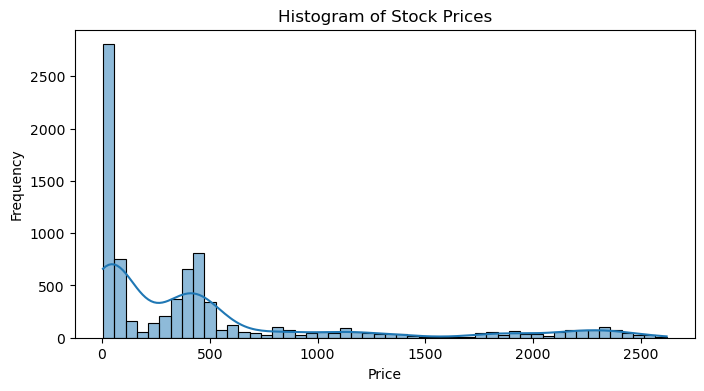

In [33]:
# Plot histograms for the given data

# Plot histogram for 'Price'
plt.figure(figsize=(8, 4))
sns.histplot(df['Price'], bins=50, kde=True)
plt.title('Histogram of Stock Prices')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

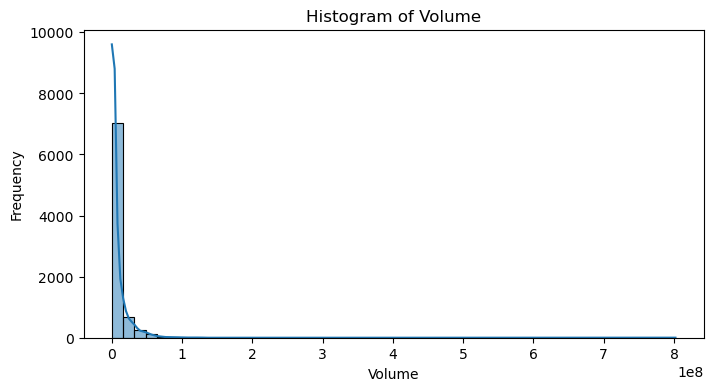

In [34]:
# Plot histogram for 'Vol.'
plt.figure(figsize=(8, 4))
sns.histplot(df['Vol.'], bins=50, kde=True)
plt.title('Histogram of Volume')
plt.xlabel('Volume')
plt.ylabel('Frequency')
plt.show()

* Volume column is also totally right skewed
* Hence, apply tranformations

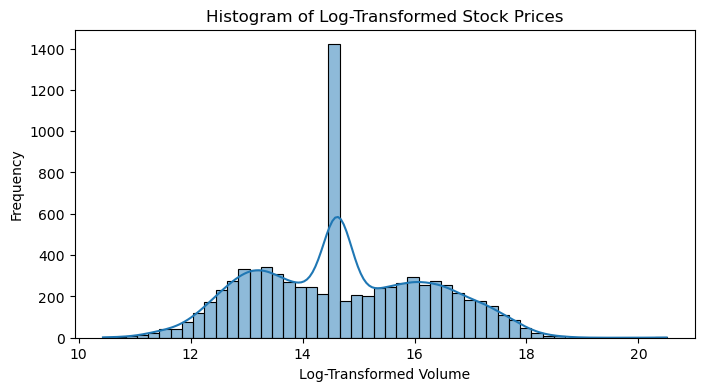

In [35]:
# Log transformation
log_volume = np.log(df['Vol.'])

# Plot histogram for log-transformed 'Price'
plt.figure(figsize=(8, 4))
sns.histplot(log_volume, bins=50, kde=True)
plt.title('Histogram of Log-Transformed Stock Prices')
plt.xlabel('Log-Transformed Volume')
plt.ylabel('Frequency')
plt.show()

In [36]:
reliance_ma=df.copy()
reliance_ma['30-day MA']=df['Price'].rolling(window=30).mean()
reliance_ma['100-day MA']=df['Price'].rolling(window=100).mean()

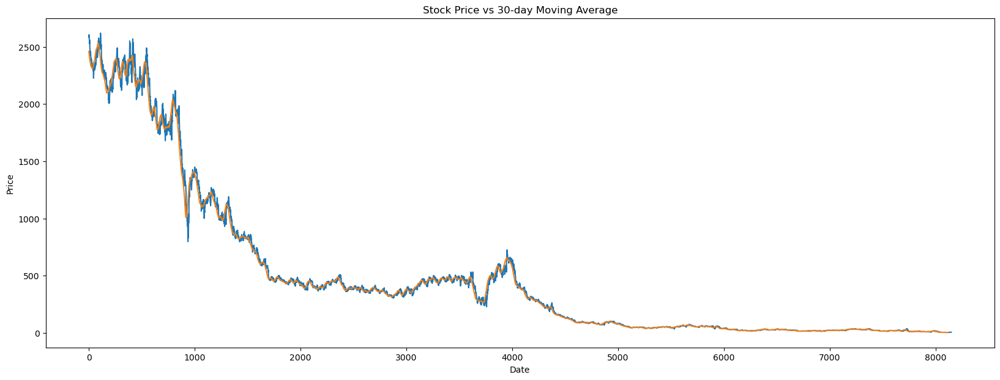

In [37]:
plt.figure(figsize=(20,7))
plt.plot(reliance_ma['Price'],label='Original data')
plt.plot(reliance_ma['30-day MA'],label='30-MA')
plt.legend
plt.title('Stock Price vs 30-day Moving Average')
plt.xlabel('Date')
plt.ylabel('Price')
plt.show()

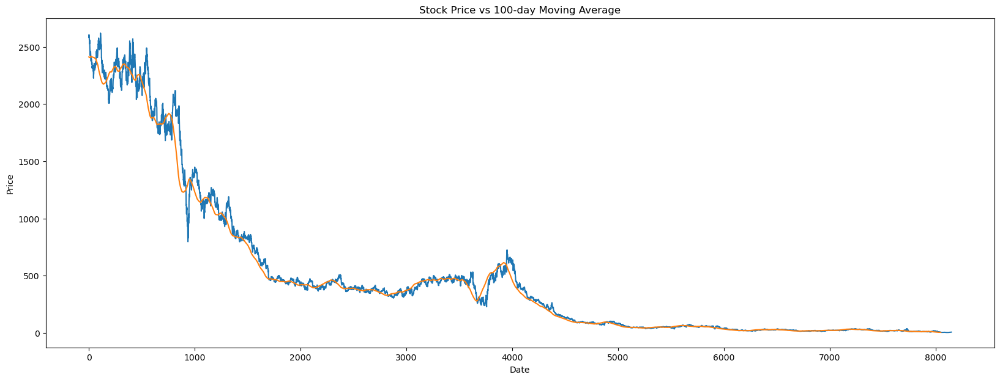

In [38]:
plt.figure(figsize=(20,7))
plt.plot(reliance_ma['Price'],label='Original data')
plt.plot(reliance_ma['100-day MA'],label='100-MA')
plt.legend
plt.title('Stock Price vs 100-day Moving Average')
plt.xlabel('Date')
plt.ylabel('Price')
plt.show()

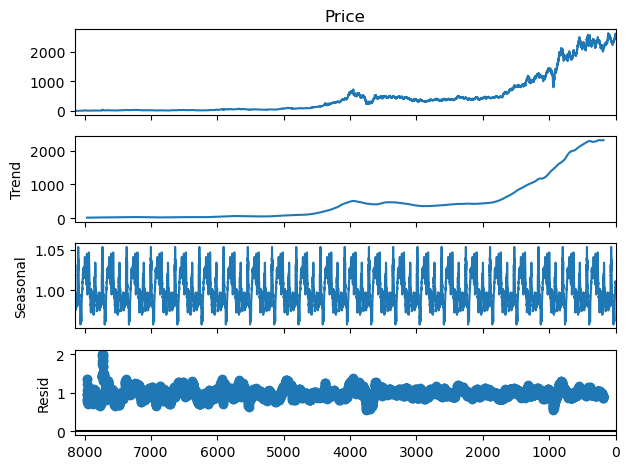

In [39]:
# Seasonality decomposition
from statsmodels.tsa.seasonal import seasonal_decompose

decompose_result = seasonal_decompose(df['Price'], model='multiplicative', period=365)
decompose_result.plot()
plt.show()

In [40]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


from math import sqrt
import plotly.express as px
from scipy.stats import boxcox
import plotly.graph_objects as go
from pandas.plotting import lag_plot
import statsmodels.formula.api as smf
from plotly.subplots import make_subplots

import warnings
warnings.filterwarnings('ignore')

In [41]:
df.head()

,Date,Price,Open,High,Low,Vol.,Change %
8148,1990-01-02,7.27,7.31,7.44,7.14,2250000.0,-1.62
8147,1990-01-03,6.92,7.18,7.18,6.84,2250000.0,-4.81
8146,1990-01-04,6.50,6.24,6.58,6.24,2250000.0,-6.07
8145,1990-01-05,6.71,6.37,6.71,6.37,2250000.0,3.23
8144,1990-01-08,6.71,7.05,7.05,6.67,2250000.0,0.00


Text(0.5, 1.0, 'Low Price')

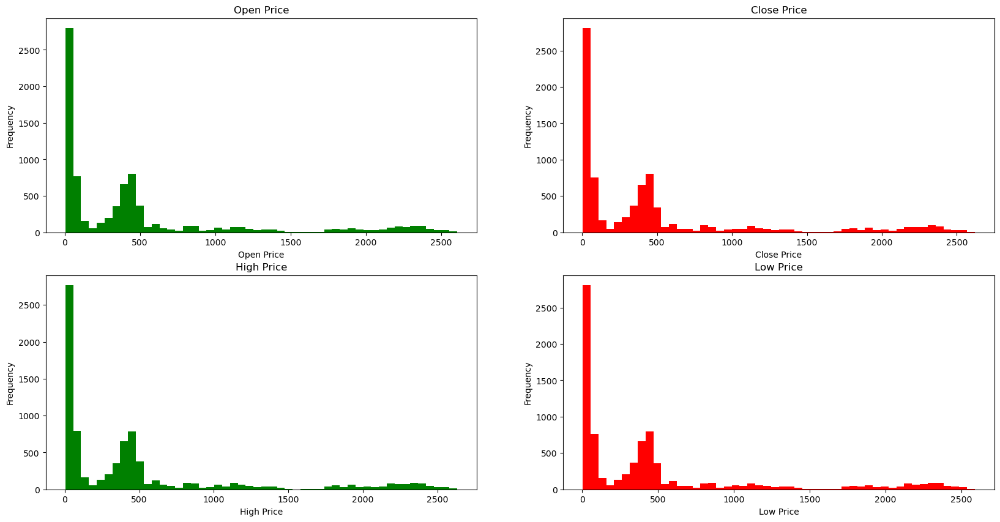

In [42]:
# Ploting Histogram
plt.figure(figsize=(20,10))
#Plot 1
plt.subplot(2,2,1)
plt.hist(df['Open'],bins=50, color='green')
plt.xlabel("Open Price")
plt.ylabel("Frequency")
plt.title('Open Price')
#Plot 2
plt.subplot(2,2,2)
plt.hist(df['Price'],bins=50, color='red')
plt.xlabel("Close Price")
plt.ylabel("Frequency")
plt.title('Close Price')
#Plot 3
plt.subplot(2,2,3)
plt.hist(df['High'],bins=50, color='green')
plt.xlabel("High Price")
plt.ylabel("Frequency")
plt.title('High Price')
#Plot 4
plt.subplot(2,2,4)
plt.hist(df['Low'],bins=50, color='red')
plt.xlabel("Low Price")
plt.ylabel("Frequency")
plt.title('Low Price')

Text(0.5, 1.0, 'Low Price')

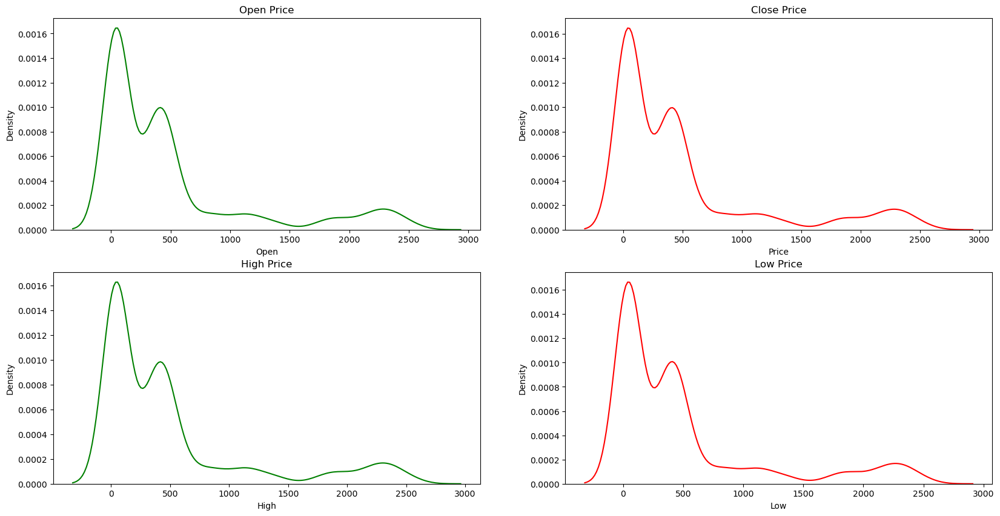

In [43]:
# KDE-Plots
plt.figure(figsize=(20,10))
#Plot 1
plt.subplot(2,2,1)
sns.kdeplot(df['Open'], color='green')
plt.title('Open Price')
#Plot 2
plt.subplot(2,2,2)
sns.kdeplot(df['Price'], color='red')
plt.title('Close Price')
#Plot 3
plt.subplot(2,2,3)
sns.kdeplot(df['High'], color='green')
plt.title('High Price')
#Plot 4
plt.subplot(2,2,4)
sns.kdeplot(df['Low'], color='red')
plt.title('Low Price')

#### Long term and short term trends can be identified using the Moving Average graphs

-In long term, Stock price is in upward trend.

-Short term trends can be identified from MA-30 chart.

-Stock had a major short term downtrend during the year 2020.

-It may be due to the bearish market during the Covid-19 outbraek

#### As shown in the graph Reliance share 2008 fall reasons

-Global Financial Crisis: The collapse of Lehman Brothers and the ensuing credit crunch led to a global economic downturn, affecting stock markets worldwide.

-Oil Prices and Refining Margins: Fluctuations in global oil prices and shrinking refining margins impacted Reliance's business.

-Company-Specific Concerns: High debt levels and uncertainty about large investment projects added to negative sentiment.


# Model Building

In [44]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM, GRU

from itertools import cycle

import plotly.graph_objects as go
import plotly.express as px

In [45]:
df

,Date,Price,Open,High,Low,Vol.,Change %
8148,1990-01-02,7.27,7.31,7.44,7.14,2250000.0,-1.62
8147,1990-01-03,6.92,7.18,7.18,6.84,2250000.0,-4.81
8146,1990-01-04,6.50,6.24,6.58,6.24,2250000.0,-6.07
8145,1990-01-05,6.71,6.37,6.71,6.37,2250000.0,3.23
8144,1990-01-08,6.71,7.05,7.05,6.67,2250000.0,0.00
...,...,...,...,...,...,...,...
4,2023-12-22,2564.70,2562.20,2580.55,2548.00,524560.0,0.10
3,2023-12-26,2577.50,2570.00,2592.90,2563.00,90280.0,0.50
2,2023-12-27,2586.35,2578.50,2599.35,2572.25,103810.0,0.34
1,2023-12-28,2605.80,2587.00,2611.35,2587.00,183810.0,0.75


In [46]:
# Removing "Change %" columnfrom dataset
reliance=df.drop(["Change %"],axis=1)
reliance

,Date,Price,Open,High,Low,Vol.
8148,1990-01-02,7.27,7.31,7.44,7.14,2250000.0
8147,1990-01-03,6.92,7.18,7.18,6.84,2250000.0
8146,1990-01-04,6.50,6.24,6.58,6.24,2250000.0
8145,1990-01-05,6.71,6.37,6.71,6.37,2250000.0
8144,1990-01-08,6.71,7.05,7.05,6.67,2250000.0
...,...,...,...,...,...,...
4,2023-12-22,2564.70,2562.20,2580.55,2548.00,524560.0
3,2023-12-26,2577.50,2570.00,2592.90,2563.00,90280.0
2,2023-12-27,2586.35,2578.50,2599.35,2572.25,103810.0
1,2023-12-28,2605.80,2587.00,2611.35,2587.00,183810.0


In [47]:
# Finding duplicate columns, if any
df.duplicated().sum()

0

In [48]:
# Finding null values, if any
df.isnull().sum()

Date        0
Price       0
Open        0
High        0
Low         0
Vol.        0
Change %    0
dtype: int64

In [49]:
reliance = df.dropna()
print(reliance)

           Date    Price     Open     High      Low       Vol.  Change %
8148 1990-01-02     7.27     7.31     7.44     7.14  2250000.0     -1.62
8147 1990-01-03     6.92     7.18     7.18     6.84  2250000.0     -4.81
8146 1990-01-04     6.50     6.24     6.58     6.24  2250000.0     -6.07
8145 1990-01-05     6.71     6.37     6.71     6.37  2250000.0      3.23
8144 1990-01-08     6.71     7.05     7.05     6.67  2250000.0      0.00
...         ...      ...      ...      ...      ...        ...       ...
4    2023-12-22  2564.70  2562.20  2580.55  2548.00   524560.0      0.10
3    2023-12-26  2577.50  2570.00  2592.90  2563.00    90280.0      0.50
2    2023-12-27  2586.35  2578.50  2599.35  2572.25   103810.0      0.34
1    2023-12-28  2605.80  2587.00  2611.35  2587.00   183810.0      0.75
0    2023-12-29  2584.85  2608.05  2614.80  2579.15   848450.0     -0.80

[8149 rows x 7 columns]


In [50]:
reliance.isnull().sum()

Date        0
Price       0
Open        0
High        0
Low         0
Vol.        0
Change %    0
dtype: int64

In [51]:
reliance.head()

,Date,Price,Open,High,Low,Vol.,Change %
8148,1990-01-02,7.27,7.31,7.44,7.14,2250000.0,-1.62
8147,1990-01-03,6.92,7.18,7.18,6.84,2250000.0,-4.81
8146,1990-01-04,6.50,6.24,6.58,6.24,2250000.0,-6.07
8145,1990-01-05,6.71,6.37,6.71,6.37,2250000.0,3.23
8144,1990-01-08,6.71,7.05,7.05,6.67,2250000.0,0.00


In [52]:
# Changes The Date column as index columns 
reliance.index =pd.to_datetime(reliance['Date']) 
reliance
  
# drop The original date column 
reliance = reliance.drop(['Date'], axis='columns') 
reliance

,Price,Open,High,Low,Vol.,Change %
Date,,,,,,
1990-01-02,7.27,7.31,7.44,7.14,2250000.0,-1.62
1990-01-03,6.92,7.18,7.18,6.84,2250000.0,-4.81
1990-01-04,6.50,6.24,6.58,6.24,2250000.0,-6.07
1990-01-05,6.71,6.37,6.71,6.37,2250000.0,3.23
1990-01-08,6.71,7.05,7.05,6.67,2250000.0,0.00
...,...,...,...,...,...,...
2023-12-22,2564.70,2562.20,2580.55,2548.00,524560.0,0.10
2023-12-26,2577.50,2570.00,2592.90,2563.00,90280.0,0.50
2023-12-27,2586.35,2578.50,2599.35,2572.25,103810.0,0.34


In [53]:
# Creating dataframe which only includes date and close time

close_df=pd.DataFrame(reliance['Price'])
close_df

,Price
Date,
1990-01-02,7.27
1990-01-03,6.92
1990-01-04,6.50
1990-01-05,6.71
1990-01-08,6.71
...,...
2023-12-22,2564.70
2023-12-26,2577.50
2023-12-27,2586.35


In [54]:
print(close_df.shape)

(8149, 1)


In [55]:
close_df=close_df.reset_index()

In [56]:
close_df['Date']

0      1990-01-02
1      1990-01-03
2      1990-01-04
3      1990-01-05
4      1990-01-08
          ...    
8144   2023-12-22
8145   2023-12-26
8146   2023-12-27
8147   2023-12-28
8148   2023-12-29
Name: Date, Length: 8149, dtype: datetime64[ns]

### Normalizing / scaling close value between 0 to 1

In [57]:
close_stock = close_df.copy()
del close_df['Date']
scaler=MinMaxScaler(feature_range=(0,1))
closedf=scaler.fit_transform(np.array(close_df).reshape(-1,1))
print(closedf.shape)

(8149, 1)


### Split data for training and testing

In [58]:
training_size=int(len(closedf)*0.86)
test_size=len(closedf)-training_size
train_data,test_data=closedf[0:training_size,:],closedf[training_size:len(closedf),:1]
print("train_data: ", train_data.shape)
print("test_data: ", test_data.shape)

train_data:  (7008, 1)
test_data:  (1141, 1)


### Create new dataset according to requirement of time-series prediction

In [59]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]   ###i=0, 0,1,2,3-----99   100
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

In [60]:
# reshape into X=t,t+1,t+2,t+3 and Y=t+4
time_step = 13
X_train, y_train = create_dataset(train_data, time_step)
X_test, y_test = create_dataset(test_data, time_step)

print("X_train: ", X_train.shape)
print("y_train: ", y_train.shape)
print("X_test: ", X_test.shape)
print("y_test", y_test.shape)

X_train:  (6994, 13)
y_train:  (6994,)
X_test:  (1127, 13)
y_test (1127,)


### Algorithms

### Support vector regression - SVR

In [61]:
import math
from sklearn.svm import SVR

svr_rbf = SVR(kernel= 'rbf', C= 1e3, gamma= 0.01)
svr_rbf.fit(X_train, y_train)

SVR(C=1000.0, gamma=0.01)

In [62]:
# Lets Do the prediction

train_predict=svr_rbf.predict(X_train)
test_predict=svr_rbf.predict(X_test)

train_predict = train_predict.reshape(-1,1)
test_predict = test_predict.reshape(-1,1)

print("Train data prediction:", train_predict.shape)
print("Test data prediction:", test_predict.shape)

Train data prediction: (6994, 1)
Test data prediction: (1127, 1)


In [63]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1))
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1))

### Evaluation metrices RMSE, MSE and MAE
Root Mean Square Error (RMSE), Mean Square Error (MSE) and Mean absolute Error (MAE) are a standard way to measure the error of a model in predicting quantitative data.

In [64]:
# Evaluation metrices RMSE and MAE
print("Train data RMSE: ", math.sqrt(mean_squared_error(original_ytrain,train_predict)))
print("Train data MSE: ", mean_squared_error(original_ytrain,train_predict))
print("Test data MAE: ", mean_absolute_error(original_ytrain,train_predict))
print("-------------------------------------------------------------------------------------")
print("Test data RMSE: ", math.sqrt(mean_squared_error(original_ytest,test_predict)))
print("Test data MSE: ", mean_squared_error(original_ytest,test_predict))
print("Test data MAE: ", mean_absolute_error(original_ytest,test_predict))

Train data RMSE:  194.06896160965547
Train data MSE:  37662.76186024993
Test data MAE:  177.91138515956922
-------------------------------------------------------------------------------------
Test data RMSE:  556.0259373774
Test data MSE:  309164.8430364164
Test data MAE:  520.4823745636414


### Explained variance regression score
The explained variance score explains the dispersion of errors of a given dataset, and the formula is written as follows: Here, and Var(y) is the variance of prediction errors and actual values respectively. Scores close to 1.0 are highly desired, indicating better squares of standard deviations of errors.

In [65]:
print("Train data explained variance regression score:", explained_variance_score(original_ytrain, train_predict))
print("Test data explained variance regression score:", explained_variance_score(original_ytest, test_predict))

Train data explained variance regression score: 0.8496368999890223
Test data explained variance regression score: 0.797968532102661


### R2 score for regression
R-squared (R2) is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model.

1 = Best

0 or < 0 = worse

In [66]:
train_r2_svr=r2_score(original_ytrain, train_predict)
test_r2_svr=r2_score(original_ytest, test_predict)
print("Train data R2 score:", train_r2_svr)
print("Test data R2 score:", test_r2_svr)

Train data R2 score: 0.46863453676443834
Test data R2 score: -0.5997215010146655


### Comparision between original stock close price vs predicted close price

In [67]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

names = cycle(['Original close price','Train predicted close price','Test predicted close price'])

plotdf = pd.DataFrame({'Date': close_stock['Date'], 'original_close': close_stock['Price'],'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['Date'], y=[plotdf['original_close'],plotdf['train_predicted_close'],plotdf['test_predicted_close']],labels={'value':'Stock price','Date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (8149, 1)
Test predicted data:  (8149, 1)


### Predicting next 5 years

In [68]:
x_input=test_data[len(test_data)-time_step:].reshape(1,-1)
temp_input=list(x_input)
temp_input=temp_input[0].tolist()

from numpy import array

lst_output=[]
n_steps=time_step
i=0
pred_years = 5
while(i<pred_years):

    if(len(temp_input)>time_step):

        x_input=np.array(temp_input[1:])
        #print("{} day input {}".format(i,x_input))
        x_input=x_input.reshape(1,-1)

        yhat = svr_rbf.predict(x_input)
        #print("{} day output {}".format(i,yhat))
        temp_input.extend(yhat.tolist())
        temp_input=temp_input[1:]

        lst_output.extend(yhat.tolist())
        i=i+1

    else:
        yhat = svr_rbf.predict(x_input)

        temp_input.extend(yhat.tolist())
        lst_output.extend(yhat.tolist())

        i=i+1

print("Output of predicted next years: ", len(lst_output))

Output of predicted next years:  5


In [69]:
last_years=np.arange(1,time_step+1)
years_pred=np.arange(time_step+1,time_step+pred_years+1)
print(last_years)
print(years_pred)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13]
[14 15 16 17 18]


In [70]:
temp_mat = np.empty((len(last_years)+pred_years+1,1))
temp_mat[:] = np.nan
temp_mat = temp_mat.reshape(1,-1).tolist()[0]

last_original_years_value = temp_mat
next_predicted_years_value = temp_mat

last_original_years_value[0:time_step+1] = scaler.inverse_transform(closedf[len(closedf)-time_step:]).reshape(1,-1).tolist()[0]
next_predicted_years_value[time_step+1:] = scaler.inverse_transform(np.array(lst_output).reshape(-1,1)).reshape(1,-1).tolist()[0]

new_pred_plot = pd.DataFrame({
    'last_original_years_value':last_original_years_value,
    'next_predicted_years_value':next_predicted_years_value
})

names = cycle(['Last 32 years close price','Predicted next 5 years close price'])

fig = px.line(new_pred_plot,x=new_pred_plot.index, y=[new_pred_plot['last_original_years_value'],
                                                      new_pred_plot['next_predicted_years_value']],
              labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Compare last 32 years vs next 5 years',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

### Plotting whole closing stock price with prediction

In [71]:
svrdf=closedf.tolist()
svrdf.extend((np.array(lst_output).reshape(-1,1)).tolist())
svrdf=scaler.inverse_transform(svrdf).reshape(1,-1).tolist()[0]

names = cycle(['Close Price'])

fig = px.line(svrdf,labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Plotting whole closing stock price with prediction',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Stock')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

# Random Forest Regressor - RF

In [72]:
 from sklearn.ensemble import RandomForestRegressor

regressor = RandomForestRegressor(n_estimators = 100, random_state = 0)
regressor.fit(X_train, y_train)

RandomForestRegressor(random_state=0)

In [73]:
# Lets Do the prediction

train_predict=regressor.predict(X_train)
test_predict=regressor.predict(X_test)

train_predict = train_predict.reshape(-1,1)
test_predict = test_predict.reshape(-1,1)

print("Train data prediction:", train_predict.shape)
print("Test data prediction:", test_predict.shape)

Train data prediction: (6994, 1)
Test data prediction: (1127, 1)


In [74]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1))
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1))

### Evaluation metrices RMSE, MSE and MAE
Root Mean Square Error (RMSE), Mean Square Error (MSE) and Mean absolute Error (MAE) are a standard way to measure the error of a model in predicting quantitative data.

In [75]:
# Evaluation metrices RMSE and MAE
print("Train data RMSE: ", math.sqrt(mean_squared_error(original_ytrain,train_predict)))
print("Train data MSE: ", mean_squared_error(original_ytrain,train_predict))
print("Test data MAE: ", mean_absolute_error(original_ytrain,train_predict))
print("-------------------------------------------------------------------------------------")
print("Test data RMSE: ", math.sqrt(mean_squared_error(original_ytest,test_predict)))
print("Test data MSE: ", mean_squared_error(original_ytest,test_predict))
print("Test data MAE: ", mean_absolute_error(original_ytest,test_predict))

Train data RMSE:  2.8774122580525305
Train data MSE:  8.279501302790962
Test data MAE:  1.4746476980268797
-------------------------------------------------------------------------------------
Test data RMSE:  830.0205977168847
Test data MSE:  688934.1926342945
Test data MAE:  723.1166307897064


### Explained variance regression score
The explained variance score explains the dispersion of errors of a given dataset, and the formula is written as follows: Here, and Var(y) is the variance of prediction errors and actual values respectively. Scores close to 1.0 are highly desired, indicating better squares of standard deviations of errors.

In [76]:
print("Train data explained variance regression score:", explained_variance_score(original_ytrain, train_predict))
print("Test data explained variance regression score:", explained_variance_score(original_ytest, test_predict))

Train data explained variance regression score: 0.999883192830371
Test data explained variance regression score: 0.12443311945112234


### R2 score for regression
R-squared (R2) is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model.

1 = Best 0 or < 0 = worse

In [77]:
train_r2_rf=r2_score(original_ytrain, train_predict)
test_r2_rf=r2_score(original_ytest, test_predict)
print("Train data R2 score:", train_r2_rf)
print("Test data R2 score:", test_r2_rf)

Train data R2 score: 0.9998831885706778
Test data R2 score: -2.564774150634728


### Comparision between original stock close price vs predicted close price

In [78]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

names = cycle(['Original close price','Train predicted close price','Test predicted close price'])


plotdf = pd.DataFrame({'Date': close_stock['Date'],
                       'original_close': close_stock['Price'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['Date'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Stock price','Date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black', legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (8149, 1)
Test predicted data:  (8149, 1)


### Predicting next 5 years

In [79]:
x_input=test_data[len(test_data)-time_step:].reshape(1,-1)
temp_input=list(x_input)
temp_input=temp_input[0].tolist()

from numpy import array

lst_output=[]
n_steps=time_step
i=0
pred_years = 5
while(i<pred_years):

    if(len(temp_input)>time_step):

        x_input=np.array(temp_input[1:])
        #print("{} year input {}".format(i,x_input))
        x_input=x_input.reshape(1,-1)

        yhat = regressor.predict(x_input)
        #print("{} year output {}".format(i,yhat))
        temp_input.extend(yhat.tolist())
        temp_input=temp_input[1:]

        lst_output.extend(yhat.tolist())
        i=i+1

    else:
        yhat = regressor.predict(x_input)

        temp_input.extend(yhat.tolist())
        lst_output.extend(yhat.tolist())

        i=i+1

print("Output of predicted next years : ", len(lst_output))


Output of predicted next years :  5


In [80]:
last_years=np.arange(1,time_step+1)
year_pred=np.arange(time_step+1,time_step+pred_years+1)
print(last_years)
print(year_pred)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13]
[14 15 16 17 18]


In [81]:
temp_mat = np.empty((len(last_years)+pred_years+1,1))
temp_mat[:] = np.nan
temp_mat = temp_mat.reshape(1,-1).tolist()[0]

last_original_days_value = temp_mat
next_predicted_days_value = temp_mat

last_original_days_value[0:time_step+1] = scaler.inverse_transform(closedf[len(closedf)-time_step:]).reshape(1,-1).tolist()[0]
next_predicted_days_value[time_step+1:] = scaler.inverse_transform(np.array(lst_output).reshape(-1,1)).reshape(1,-1).tolist()[0]

names = cycle(['Last 32 years close price','Predicted next 5 years close price'])

new_pred_plot = pd.DataFrame({
    'last_original_years_value':last_original_years_value,
    'next_predicted_years_value':next_predicted_years_value
})

fig = px.line(new_pred_plot,x=new_pred_plot.index, y=[new_pred_plot['last_original_years_value'],
                                                      new_pred_plot['next_predicted_years_value']],
              labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Compare last 32 years vs next 5 years',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

### Plotting whole closing stock price with prediction

In [82]:
rfdf=closedf.tolist()
rfdf.extend((np.array(lst_output).reshape(-1,1)).tolist())
rfdf=scaler.inverse_transform(rfdf).reshape(1,-1).tolist()[0]

names = cycle(['Close price'])

fig = px.line(rfdf,labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Plotting whole closing stock price with prediction',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Stock')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

### K-nearest neighgbour - KNN

In [83]:
from sklearn import neighbors

K = time_step
neighbor = neighbors.KNeighborsRegressor(n_neighbors = K)
neighbor.fit(X_train, y_train)

KNeighborsRegressor(n_neighbors=13)

In [84]:
# Lets Do the prediction

train_predict=neighbor.predict(X_train)
test_predict=neighbor.predict(X_test)

train_predict = train_predict.reshape(-1,1)
test_predict = test_predict.reshape(-1,1)

print("Train data prediction:", train_predict.shape)
print("Test data prediction:", test_predict.shape)

Train data prediction: (6994, 1)
Test data prediction: (1127, 1)


In [85]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1))
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1))

### Evaluation metrices RMSE, MSE and MAE
Root Mean Square Error (RMSE), Mean Square Error (MSE) and Mean absolute Error (MAE) are a standard way to measure the error of a model in predicting quantitative data.

In [86]:
# Evaluation metrices RMSE and MAE
print("Train data RMSE: ", math.sqrt(mean_squared_error(original_ytrain,train_predict)))
print("Train data MSE: ", mean_squared_error(original_ytrain,train_predict))
print("Test data MAE: ", mean_absolute_error(original_ytrain,train_predict))
print("-------------------------------------------------------------------------------------")
print("Test data RMSE: ", math.sqrt(mean_squared_error(original_ytest,test_predict)))
print("Test data MSE: ", mean_squared_error(original_ytest,test_predict))
print("Test data MAE: ", mean_absolute_error(original_ytest,test_predict))

Train data RMSE:  8.917068419222032
Train data MSE:  79.5141091930869
Test data MAE:  4.4857107190778915
-------------------------------------------------------------------------------------
Test data RMSE:  860.1129757562013
Test data MSE:  739794.3310641878
Test data MAE:  755.5715336837076


### Explained variance regression score
The explained variance score explains the dispersion of errors of a given dataset, and the formula is written as follows: Here, and Var(y) is the variance of prediction errors and actual values respectively. Scores close to 1.0 are highly desired, indicating better squares of standard deviations of errors.

In [87]:
print("Train data explained variance regression score:", explained_variance_score(original_ytrain, train_predict))
print("Test data explained variance regression score:", explained_variance_score(original_ytest, test_predict))

Train data explained variance regression score: 0.9988782044567254
Test data explained variance regression score: 0.08320357524164002


### R2 score for regression
R-squared (R2) is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model.

1 = Best 0 or < 0 = worse

In [88]:
train_r2_knn=r2_score(original_ytrain, train_predict)
test_r2_knn=r2_score(original_ytest, test_predict)
print("Train data R2 score:", train_r2_knn)
print("Test data R2 score:", test_r2_knn)

Train data R2 score: 0.9988781743722905
Test data R2 score: -2.827941385925123


### Comparision between original stock close price vs predicted close price

In [89]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

names = cycle(['Original close price','Train predicted close price','Test predicted close price'])

plotdf = pd.DataFrame({'Date': close_stock['Date'],
                       'original_close': close_stock['Close Price'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['Date'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Stock price','Date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (8149, 1)
Test predicted data:  (8149, 1)


KeyError: 'Close Price'

### Predicting next 5 years

In [ ]:
x_input=test_data[len(test_data)-time_step:].reshape(1,-1)
temp_input=list(x_input)
temp_input=temp_input[0].tolist()

from numpy import array

lst_output=[]
n_steps=time_step
i=0
pred_years = 5
while(i<pred_years):

    if(len(temp_input)>time_step):

        x_input=np.array(temp_input[1:])
        #print("{} year input {}".format(i,x_input))
        x_input=x_input.reshape(1,-1)

        yhat = neighbor.predict(x_input)
        #print("{} year output {}".format(i,yhat))
        temp_input.extend(yhat.tolist())
        temp_input=temp_input[1:]

        lst_output.extend(yhat.tolist())
        i=i+1

    else:
        yhat = neighbor.predict(x_input)

        temp_input.extend(yhat.tolist())
        lst_output.extend(yhat.tolist())

        i=i+1

print("Output of predicted next years: ", len(lst_output))

In [90]:
last_years=np.arange(1,time_step+1)
year_pred=np.arange(time_step+1,time_step+pred_years+1)
print(last_years)
print(year_pred)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13]
[14 15 16 17 18]


In [91]:
temp_mat = np.empty((len(last_years)+pred_years+1,1))
temp_mat[:] = np.nan
temp_mat = temp_mat.reshape(1,-1).tolist()[0]

last_original_years_value = temp_mat
next_predicted_years_value = temp_mat

last_original_years_value[0:time_step+1] = scaler.inverse_transform(closedf[len(closedf)-time_step:]).reshape(1,-1).tolist()[0]
next_predicted_years_value[time_step+1:] = scaler.inverse_transform(np.array(lst_output).reshape(-1,1)).reshape(1,-1).tolist()[0]

new_pred_plot = pd.DataFrame({
    'last_original_years_value':last_original_years_value,
    'next_predicted_years_value':next_predicted_years_value
})

names = cycle(['Last 32 years close price','Predicted next 5 years close price'])

fig = px.line(new_pred_plot,x=new_pred_plot.index, y=[new_pred_plot['last_original_years_value'],
                                                      new_pred_plot['next_predicted_years_value']],
              labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Compare last 32 years vs next 5 years',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()


### Plotting whole closing stock price with prediction

In [92]:
knndf=closedf.tolist()
knndf.extend((np.array(lst_output).reshape(-1,1)).tolist())
knndf=scaler.inverse_transform(knndf).reshape(1,-1).tolist()[0]

names = cycle(['Close price'])

fig = px.line(knndf,labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Plotting whole closing stock price with prediction',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Stock')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()


# LSTM

In [93]:
# reshape input to be [samples, time steps, features] which is required for LSTM
X_train =X_train.reshape(X_train.shape[0],X_train.shape[1] , 1)
X_test = X_test.reshape(X_test.shape[0],X_test.shape[1] , 1)

print("X_train: ", X_train.shape)
print("X_test: ", X_test.shape)

X_train:  (6994, 13, 1)
X_test:  (1127, 13, 1)


### LSTM model structure

In [94]:
tf.keras.backend.clear_session()
model=Sequential()
model.add(LSTM(32,return_sequences=True,input_shape=(time_step,1)))
model.add(LSTM(32,return_sequences=True))
model.add(LSTM(32))
model.add(Dense(1))
model.compile(loss='mean_squared_error',optimizer='adam')

In [95]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 13, 32)              │           4,352 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 13, 32)              │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_2 (LSTM)                        │ (None, 32)                  │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 21,025 (82.13 KB)

 Trainable params: 21,025 (82.13 KB)

 Non-trainable params: 0 (0.00 B)

In [97]:
model.fit(X_train,y_train,validation_data=(X_test,y_test),epochs=10,batch_size=32,verbose=1)

Epoch 1/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 23ms/step - loss: 4.2229e-05 - val_loss: 0.0032
Epoch 2/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 4s 16ms/step - loss: 3.8656e-05 - val_loss: 0.0026
Epoch 3/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - loss: 3.4493e-05 - val_loss: 0.0011
Epoch 4/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 7s 23ms/step - loss: 3.4095e-05 - val_loss: 0.0014
Epoch 5/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - loss: 3.2424e-05 - val_loss: 7.7069e-04
Epoch 6/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 20ms/step - loss: 3.1174e-05 - val_loss: 0.0018
Epoch 7/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - loss: 2.7082e-05 - val_loss: 6.4103e-04
Epoch 8/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - loss: 3.2633e-05 - val_loss: 0.0010
Epoch 9/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 19ms/step - loss: 2.3210e-05 - val_loss: 6.7230e-04
Epoch 10/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 17ms/step - loss: 2.3933e-05 - val_loss: 0.0015


In [98]:
### Lets Do the prediction and check performance metrics
train_predict=model.predict(X_train)
test_predict=model.predict(X_test)
train_predict.shape, test_predict.shape

219/219 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


((6994, 1), (1127, 1))

In [99]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1))
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1))

### Evaluation metrices RMSE, MSE and MAE
Root Mean Square Error (RMSE), Mean Square Error (MSE) and Mean absolute Error (MAE) are a standard way to measure the error of a model in predicting quantitative data.

In [100]:
# Evaluation metrices RMSE and MAE
print("Train data RMSE: ", math.sqrt(mean_squared_error(original_ytrain,train_predict)))
print("Train data MSE: ", mean_squared_error(original_ytrain,train_predict))
print("Test data MAE: ", mean_absolute_error(original_ytrain,train_predict))
print("-------------------------------------------------------------------------------------")
print("Test data RMSE: ", math.sqrt(mean_squared_error(original_ytest,test_predict)))
print("Test data MSE: ", mean_squared_error(original_ytest,test_predict))
print("Test data MAE: ", mean_absolute_error(original_ytest,test_predict))

Train data RMSE:  12.319820707071685
Train data MSE:  151.77798225439227
Test data MAE:  8.613227083268917
-------------------------------------------------------------------------------------
Test data RMSE:  100.67215308247033
Test data MSE:  10134.882406260342
Test data MAE:  85.47144055966476


### Explained variance regression score
The explained variance score explains the dispersion of errors of a given dataset, and the formula is written as follows: Here, and Var(y) is the variance of prediction errors and actual values respectively. Scores close to 1.0 are highly desired, indicating better squares of standard deviations of errors.

In [101]:
print("Train data explained variance regression score:", explained_variance_score(original_ytrain, train_predict))
print("Test data explained variance regression score:", explained_variance_score(original_ytest, test_predict))

Train data explained variance regression score: 0.9984331223575209
Test data explained variance regression score: 0.9817440675238394


### R2 score for regression
R-squared (R2) is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model.

1 = Best 0 or < 0 = worse

In [102]:
train_r2_lstm=r2_score(original_ytrain, train_predict)
test_r2_lstm=r2_score(original_ytest, test_predict)
print("Train data R2 score:", train_r2_lstm)
print("Test data R2 score:", test_r2_lstm)

Train data R2 score: 0.9978586387756474
Test data R2 score: 0.9475587549466606


### Comparision between original stock close price vs predicted close price

In [105]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)

names = cycle(['Original close price','Train predicted close price','Test predicted close price'])


plotdf = pd.DataFrame({'Date': close_stock['Date'],
                       'original_close': close_stock['Price'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['Date'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Stock price','Date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black', legend_title_text='Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (8149, 1)
Test predicted data:  (8149, 1)


### Predicting next 5 years

In [106]:
x_input=test_data[len(test_data)-time_step:].reshape(1,-1)
temp_input=list(x_input)
temp_input=temp_input[0].tolist()

from numpy import array

lst_output=[]
n_steps=time_step
i=0
pred_years = 5
while(i<pred_years):

    if(len(temp_input)>time_step):

        x_input=np.array(temp_input[1:])
        #print("{} day input {}".format(i,x_input))
        x_input = x_input.reshape(1,-1)
        x_input = x_input.reshape((1, n_steps, 1))

        yhat = model.predict(x_input, verbose=0)
        #print("{} day output {}".format(i,yhat))
        temp_input.extend(yhat[0].tolist())
        temp_input=temp_input[1:]
        #print(temp_input)

        lst_output.extend(yhat.tolist())
        i=i+1

    else:

        x_input = x_input.reshape((1, n_steps,1))
        yhat = model.predict(x_input, verbose=0)
        temp_input.extend(yhat[0].tolist())

        lst_output.extend(yhat.tolist())
        i=i+1

print("Output of predicted next years: ", len(lst_output))

Output of predicted next years:  5


In [107]:
last_years=np.arange(1,time_step+1)
year_pred=np.arange(time_step+1,time_step+pred_years+1)
print(last_years)
print(year_pred)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13]
[14 15 16 17 18]


In [108]:
temp_mat = np.empty((len(last_years)+pred_years+1,1))
temp_mat[:] = np.nan
temp_mat = temp_mat.reshape(1,-1).tolist()[0]

last_original_years_value = temp_mat
next_predicted_years_value = temp_mat

last_original_years_value[0:time_step+1] = scaler.inverse_transform(closedf[len(closedf)-time_step:]).reshape(1,-1).tolist()[0]
next_predicted_years_value[time_step+1:] = scaler.inverse_transform(np.array(lst_output).reshape(-1,1)).reshape(1,-1).tolist()[0]

new_pred_plot = pd.DataFrame({
    'last_original_years_value':last_original_years_value,
    'next_predicted_years_value':next_predicted_years_value
})

names = cycle(['Last 32 years close price','Predicted next 5 years close price'])

fig = px.line(new_pred_plot,x=new_pred_plot.index, y=[new_pred_plot['last_original_years_value'],
                                                      new_pred_plot['next_predicted_years_value']],
              labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Compare last 32 years vs next 5 years',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Close Price')

fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

### Plotting whole closing stock price with prediction

In [109]:
lstmdf=closedf.tolist()
lstmdf.extend((np.array(lst_output).reshape(-1,1)).tolist())
lstmdf=scaler.inverse_transform(lstmdf).reshape(1,-1).tolist()[0]

names = cycle(['Close price'])

fig = px.line(lstmdf,labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Plotting whole closing stock price with prediction',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Stock')

fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

# GRU (Gated Recurrent Unit)

In [110]:
# reshape input to be [samples, time steps, features] which is required for LSTM
X_train =X_train.reshape(X_train.shape[0],X_train.shape[1] , 1)
X_test = X_test.reshape(X_test.shape[0],X_test.shape[1] , 1)

print("X_train: ", X_train.shape)
print("X_test: ", X_test.shape)

X_train:  (6994, 13, 1)
X_test:  (1127, 13, 1)


In [111]:
tf.keras.backend.clear_session()
model=Sequential()
model.add(GRU(32,return_sequences=True,input_shape=(time_step,1)))
model.add(GRU(32,return_sequences=True))
model.add(GRU(32,return_sequences=True))
model.add(GRU(32))
model.add(Dense(1))
model.compile(loss='mean_squared_error',optimizer='adam')

In [112]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ gru (GRU)                            │ (None, 13, 32)              │           3,360 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ gru_1 (GRU)                          │ (None, 13, 32)              │           6,336 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ gru_2 (GRU)                          │ (None, 13, 32)              │           6,336 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ gru_3 (GRU)                          │ (None, 32)                  │           6,336 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 22,401 (87.50 KB)

 Trainable params: 22,401 (87.50 KB)

 Non-trainable params: 0 (0.00 B)

In [114]:
model.fit(X_train,y_train,validation_data=(X_test,y_test),epochs=10,batch_size=32,verbose=1)

Epoch 1/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 17s 42ms/step - loss: 0.0026 - val_loss: 0.0013
Epoch 2/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 9s 35ms/step - loss: 3.1783e-05 - val_loss: 0.0013
Epoch 3/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - loss: 3.6602e-05 - val_loss: 8.7359e-04
Epoch 4/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - loss: 3.9965e-05 - val_loss: 0.0012
Epoch 5/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 11s 35ms/step - loss: 2.8057e-05 - val_loss: 0.0015
Epoch 6/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 10s 35ms/step - loss: 2.9637e-05 - val_loss: 0.0010
Epoch 7/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 10s 34ms/step - loss: 2.8577e-05 - val_loss: 0.0028
Epoch 8/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 11s 36ms/step - loss: 3.0203e-05 - val_loss: 9.5649e-04
Epoch 9/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 10s 35ms/step - loss: 2.2255e-05 - val_loss: 5.2211e-04
Epoch 10/10
219/219 ━━━━━━━━━━━━━━━━━━━━ 10s 35ms/step - loss: 2.3617e-05 - val_loss: 8.3925e-04


In [115]:
### Lets Do the prediction and check performance metrics
train_predict=model.predict(X_train)
test_predict=model.predict(X_test)
train_predict.shape, test_predict.shape

219/219 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step
36/36 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


((6994, 1), (1127, 1))

In [116]:
# Transform back to original form

train_predict = scaler.inverse_transform(train_predict)
test_predict = scaler.inverse_transform(test_predict)
original_ytrain = scaler.inverse_transform(y_train.reshape(-1,1))
original_ytest = scaler.inverse_transform(y_test.reshape(-1,1))

### Evaluation metrices RMSE, MSE and MAE
Root Mean Square Error (RMSE), Mean Square Error (MSE) and Mean absolute Error (MAE) are a standard way to measure the error of a model in predicting quantitative data.

In [117]:
# Evaluation metrices RMSE and MAE
print("Train data RMSE: ", math.sqrt(mean_squared_error(original_ytrain,train_predict)))
print("Train data MSE: ", mean_squared_error(original_ytrain,train_predict))
print("Test data MAE: ", mean_absolute_error(original_ytrain,train_predict))
print("-------------------------------------------------------------------------------------")
print("Test data RMSE: ", math.sqrt(mean_squared_error(original_ytest,test_predict)))
print("Test data MSE: ", mean_squared_error(original_ytest,test_predict))
print("Test data MAE: ", mean_absolute_error(original_ytest,test_predict))

Train data RMSE:  11.576533439951337
Train data MSE:  134.01612648631155
Test data MAE:  8.98508293247036
-------------------------------------------------------------------------------------
Test data RMSE:  75.76880460633657
Test data MSE:  5740.91175147321
Test data MAE:  62.12759792920225


### Explained variance regression score
The explained variance score explains the dispersion of errors of a given dataset, and the formula is written as follows: Here, and Var(y) is the variance of prediction errors and actual values respectively. Scores close to 1.0 are highly desired, indicating better squares of standard deviations of errors.

In [118]:
print("Train data explained variance regression score:", explained_variance_score(original_ytrain, train_predict))
print("Test data explained variance regression score:", explained_variance_score(original_ytest, test_predict))

Train data explained variance regression score: 0.9986582561762974
Test data explained variance regression score: 0.9860149366704369


### R2 score for regression
R-squared (R2) is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model.

1 = Best 0 or < 0 = worse

In [119]:
train_r2_gru=r2_score(original_ytrain, train_predict)
test_r2_gru=r2_score(original_ytest, test_predict)
print("Train data R2 score:", train_r2_gru)
print("Test data R2 score:", test_r2_gru)

Train data R2 score: 0.9981092321005116
Test data R2 score: 0.9702946173502086


### Comparision between original stock close price vs predicted close price

In [121]:
# shift train predictions for plotting

look_back=time_step
trainPredictPlot = np.empty_like(closedf)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_predict)+look_back, :] = train_predict
print("Train predicted data: ", trainPredictPlot.shape)

# shift test predictions for plotting
testPredictPlot = np.empty_like(closedf)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_predict)+(look_back*2)+1:len(closedf)-1, :] = test_predict
print("Test predicted data: ", testPredictPlot.shape)


names = cycle(['Original close price','Train predicted close price','Test predicted close price'])

plotdf = pd.DataFrame({'Date': close_stock['Date'],
                       'original_close': close_stock['Price'],
                      'train_predicted_close': trainPredictPlot.reshape(1,-1)[0].tolist(),
                      'test_predicted_close': testPredictPlot.reshape(1,-1)[0].tolist()})

fig = px.line(plotdf,x=plotdf['Date'], y=[plotdf['original_close'],plotdf['train_predicted_close'],
                                          plotdf['test_predicted_close']],
              labels={'value':'Stock price','Date': 'Date'})
fig.update_layout(title_text='Comparision between original close price vs predicted close price',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

Train predicted data:  (8149, 1)
Test predicted data:  (8149, 1)


In [122]:
plotdf.head(100)

,Date,original_close,train_predicted_close,test_predicted_close
0,1990-01-02,7.27,NaN,NaN
1,1990-01-03,6.92,NaN,NaN
2,1990-01-04,6.50,NaN,NaN
3,1990-01-05,6.71,NaN,NaN
4,1990-01-08,6.71,NaN,NaN
...,...,...,...,...
95,1990-06-19,5.56,-1.893490,NaN
96,1990-06-20,5.47,-1.844574,NaN
97,1990-06-21,5.43,-1.815865,NaN
98,1990-06-22,5.98,-1.815598,NaN


### Predicting next 5 years

In [123]:
x_input=test_data[len(test_data)-time_step:].reshape(1,-1)
temp_input=list(x_input)
temp_input=temp_input[0].tolist()

from numpy import array

lst_output=[]
n_steps=time_step
i=0
pred_years = 5
while(i<pred_years):

    if(len(temp_input)>time_step):

        x_input=np.array(temp_input[1:])
        #print("{} day input {}".format(i,x_input))
        x_input = x_input.reshape(1,-1)
        x_input = x_input.reshape((1, n_steps, 1))

        yhat = model.predict(x_input, verbose=0)
        #print("{} day output {}".format(i,yhat))
        temp_input.extend(yhat[0].tolist())
        temp_input=temp_input[1:]
        #print(temp_input)

        lst_output.extend(yhat.tolist())
        i=i+1

    else:

        x_input = x_input.reshape((1, n_steps,1))
        yhat = model.predict(x_input, verbose=0)
        temp_input.extend(yhat[0].tolist())

        lst_output.extend(yhat.tolist())
        i=i+1

print("Output of predicted next years: ", len(lst_output))

Output of predicted next years:  5


In [124]:
last_years=np.arange(1,time_step+1)
year_pred=np.arange(time_step+1,time_step+pred_years+1)
print(last_years)
print(year_pred)

[ 1  2  3  4  5  6  7  8  9 10 11 12 13]
[14 15 16 17 18]


In [125]:
temp_mat = np.empty((len(last_years)+pred_years+1,1))
temp_mat[:] = np.nan
temp_mat = temp_mat.reshape(1,-1).tolist()[0]

last_original_years_value = temp_mat
next_predicted_years_value = temp_mat

last_original_years_value[0:time_step+1] = scaler.inverse_transform(closedf[len(closedf)-time_step:]).reshape(1,-1).tolist()[0]
next_predicted_years_value[time_step+1:] = scaler.inverse_transform(np.array(lst_output).reshape(-1,1)).reshape(1,-1).tolist()[0]

new_pred_plot = pd.DataFrame({
    'last_original_years_value':last_original_years_value,
    'next_predicted_years_value':next_predicted_years_value
})
names = cycle(['Last 32 years close price','Predicted next 5 years close price'])

fig = px.line(new_pred_plot,x=new_pred_plot.index, y=[new_pred_plot['last_original_years_value'],
                                                      new_pred_plot['next_predicted_years_value']],
              labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Compare last 32 years vs next 5 years',
                  plot_bgcolor='white', font_size=15, font_color='black', legend_title_text='Close Price')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

### Plotting whole closing stock price with prediction

In [126]:
grudf=closedf.tolist()
grudf.extend((np.array(lst_output).reshape(-1,1)).tolist())
grudf=scaler.inverse_transform(grudf).reshape(1,-1).tolist()[0]

names = cycle(['Close price'])
fig = px.line(grudf,labels={'value': 'Stock price','index': 'Timestamp'})
fig.update_layout(title_text='Plotting whole closing stock price with prediction',
                  plot_bgcolor='white', font_size=15, font_color='black',legend_title_text='Stock')
fig.for_each_trace(lambda t:  t.update(name = next(names)))

fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)
fig.show()

In [127]:
finaldf = pd.DataFrame({
    'svr':svrdf,
    'rf':rfdf,
    'knn':knndf,
    'lstm':lstmdf,
    'gru':grudf,
})
finaldf

,svr,rf,knn,lstm,gru
0,7.270000,7.2700,7.2700,7.270000,7.270000
1,6.920000,6.9200,6.9200,6.920000,6.920000
2,6.500000,6.5000,6.5000,6.500000,6.500000
3,6.710000,6.7100,6.7100,6.710000,6.710000
4,6.710000,6.7100,6.7100,6.710000,6.710000
...,...,...,...,...,...
8149,1752.061866,1245.4258,1245.4258,2417.228307,2461.560512
8150,1723.127782,1225.0853,1225.0853,2358.049692,2410.375279
8151,1693.141751,1218.5542,1218.5542,2279.820250,2353.875518
8152,1659.906851,1221.5006,1221.5006,2201.959648,2301.944651


In [128]:
names = cycle(['SVR', 'RF','KNN','LSTM','GRU'])

fig = px.line(finaldf[225:], x=finaldf.index[225:], y=[finaldf['svr'][225:],finaldf['rf'][225:], finaldf['knn'][225:],
                                          finaldf['lstm'][225:], finaldf['gru'][225:],],
             labels={'x': 'Timestamp','value':'Stock close price'})
fig.update_layout(title_text='Final stock analysis chart', font_size=15, font_color='black',legend_title_text='Algorithms')
fig.for_each_trace(lambda t:  t.update(name = next(names)))
fig.update_xaxes(showgrid=False)
fig.update_yaxes(showgrid=False)

fig.show()

In [129]:
data={"Model": ["SVR", "Random Forest", "KNN", "LSTM", "GRU"],
    "Train R2 Score": [train_r2_svr, train_r2_rf,train_r2_knn, train_r2_lstm, train_r2_gru],
    "Test R2 Score": [test_r2_svr, test_r2_rf, test_r2_knn, test_r2_lstm, test_r2_gru]}
df=pd.DataFrame(data)
df

,Model,Train R2 Score,Test R2 Score
0,SVR,0.468635,-0.599722
1,Random Forest,0.999883,-2.564774
2,KNN,0.998878,-2.827941
3,LSTM,0.997859,0.947559
4,GRU,0.998109,0.970295


# Conclusion
 The high performance and ease of deployment, Random Forest is likely the best overall choice for deployment.

